In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
import pandas as pd
import numpy as np
from sklearn.feature_selection import f_classif
from sklearn.feature_selection import SelectKBest
from scipy.io import arff
from sklearn.preprocessing import normalize
from sklearn.decomposition import PCA
from tqdm import tqdm
from scipy.stats import norm
from sklearn.metrics import f1_score
from sklearn.cluster import KMeans




In [3]:
train_target =  pd.DataFrame(arff.loadarff('KDDTrain+.arff')[0])

In [173]:
y_true.shape

(22544, 42)

In [172]:
y_true = pd.DataFrame(arff.loadarff('KDDTest+.arff')[0])

In [180]:
y_true_train = pd.DataFrame(arff.loadarff('KDDTrain+.arff')[0])

In [174]:
y_true.head()

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,...,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,class
0,0.0,b'tcp',b'private',b'REJ',0.0,0.0,b'0',0.0,0.0,0.0,...,10.0,0.04,0.06,0.00,0.00,0.0,0.0,1.00,1.00,b'anomaly'
1,0.0,b'tcp',b'private',b'REJ',0.0,0.0,b'0',0.0,0.0,0.0,...,1.0,0.00,0.06,0.00,0.00,0.0,0.0,1.00,1.00,b'anomaly'
2,2.0,b'tcp',b'ftp_data',b'SF',12983.0,0.0,b'0',0.0,0.0,0.0,...,86.0,0.61,0.04,0.61,0.02,0.0,0.0,0.00,0.00,b'normal'
3,0.0,b'icmp',b'eco_i',b'SF',20.0,0.0,b'0',0.0,0.0,0.0,...,57.0,1.00,0.00,1.00,0.28,0.0,0.0,0.00,0.00,b'anomaly'
4,1.0,b'tcp',b'telnet',b'RSTO',0.0,15.0,b'0',0.0,0.0,0.0,...,86.0,0.31,0.17,0.03,0.02,0.0,0.0,0.83,0.71,b'anomaly'


<h2>Importer les données</h2>

In [2]:

# importer les données
train_df = pd.DataFrame(arff.loadarff('KDDTrain+.arff')[0])
test_df = pd.DataFrame(arff.loadarff('KDDTest+.arff')[0])

### Decoder byte strings en ordinary strings: pour éviter les b'' sur les valeurs de chaines de caractères
print('Decoding byte strings into ordinary strings. (for train data)')
strings = train_df.select_dtypes([object])
strings = strings.stack().str.decode('utf-8').unstack()
for column in strings:
    train_df[column] = strings[column]

    
print('Decoding byte strings into ordinary strings. (for test data)')
strings = test_df.select_dtypes([object])
strings = strings.stack().str.decode('utf-8').unstack()
for column in strings:
    test_df[column] = strings[column]


Decoding byte strings into ordinary strings. (for train data)
Decoding byte strings into ordinary strings. (for test data)


In [168]:
print('Decoding byte strings into ordinary strings. (for test data)')
strings = y_true.select_dtypes([object])
strings = strings.stack().str.decode('utf-8').unstack()
for column in strings:
    test_df[column] = strings[column]


Decoding byte strings into ordinary strings. (for test data)


In [49]:
test_df.shape

(22544, 42)

In [50]:
test_df.head()

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,...,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,class
0,0.0,tcp,private,REJ,0.0,0.0,0,0.0,0.0,0.0,...,10.0,0.04,0.06,0.00,0.00,0.0,0.0,1.00,1.00,anomaly
1,0.0,tcp,private,REJ,0.0,0.0,0,0.0,0.0,0.0,...,1.0,0.00,0.06,0.00,0.00,0.0,0.0,1.00,1.00,anomaly
2,2.0,tcp,ftp_data,SF,12983.0,0.0,0,0.0,0.0,0.0,...,86.0,0.61,0.04,0.61,0.02,0.0,0.0,0.00,0.00,normal
3,0.0,icmp,eco_i,SF,20.0,0.0,0,0.0,0.0,0.0,...,57.0,1.00,0.00,1.00,0.28,0.0,0.0,0.00,0.00,anomaly
4,1.0,tcp,telnet,RSTO,0.0,15.0,0,0.0,0.0,0.0,...,86.0,0.31,0.17,0.03,0.02,0.0,0.0,0.83,0.71,anomaly


In [51]:
test_df.columns

Index(['duration', 'protocol_type', 'service', 'flag', 'src_bytes',
       'dst_bytes', 'land', 'wrong_fragment', 'urgent', 'hot',
       'num_failed_logins', 'logged_in', 'num_compromised', 'root_shell',
       'su_attempted', 'num_root', 'num_file_creations', 'num_shells',
       'num_access_files', 'num_outbound_cmds', 'is_host_login',
       'is_guest_login', 'count', 'srv_count', 'serror_rate',
       'srv_serror_rate', 'rerror_rate', 'srv_rerror_rate', 'same_srv_rate',
       'diff_srv_rate', 'srv_diff_host_rate', 'dst_host_count',
       'dst_host_srv_count', 'dst_host_same_srv_rate',
       'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate',
       'dst_host_srv_diff_host_rate', 'dst_host_serror_rate',
       'dst_host_srv_serror_rate', 'dst_host_rerror_rate',
       'dst_host_srv_rerror_rate', 'class'],
      dtype='object')

<h2> 3.2 Data processing </h2>

In [52]:
train_df.shape

(125973, 42)

In [53]:
train_df.select_dtypes([object])


,protocol_type,service,flag,land,logged_in,is_host_login,is_guest_login,class
0,tcp,ftp_data,SF,0,0,0,0,normal
1,udp,other,SF,0,0,0,0,normal
2,tcp,private,S0,0,0,0,0,anomaly
3,tcp,http,SF,0,1,0,0,normal
4,tcp,http,SF,0,1,0,0,normal
...,...,...,...,...,...,...,...,...
125968,tcp,private,S0,0,0,0,0,anomaly
125969,udp,private,SF,0,0,0,0,normal
125970,tcp,smtp,SF,0,1,0,0,normal
125971,tcp,klogin,S0,0,0,0,0,anomaly


<h3>Convertir les valeurs chaines de caractère en numeric </h3>

In [3]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22544 entries, 0 to 22543
Data columns (total 42 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   duration                     22544 non-null  float64
 1   protocol_type                22544 non-null  object 
 2   service                      22544 non-null  object 
 3   flag                         22544 non-null  object 
 4   src_bytes                    22544 non-null  float64
 5   dst_bytes                    22544 non-null  float64
 6   land                         22544 non-null  object 
 7   wrong_fragment               22544 non-null  float64
 8   urgent                       22544 non-null  float64
 9   hot                          22544 non-null  float64
 10  num_failed_logins            22544 non-null  float64
 11  logged_in                    22544 non-null  object 
 12  num_compromised              22544 non-null  float64
 13  root_shell      

In [3]:
#convertier les chaine en numeric
train_df["land"] = pd.to_numeric(train_df["land"])
train_df["logged_in"] = pd.to_numeric(train_df["logged_in"])
train_df["is_host_login"] = pd.to_numeric(train_df["is_host_login"])
train_df["is_guest_login"] = pd.to_numeric(train_df["is_guest_login"])

test_df["land"] = pd.to_numeric(test_df["land"])
test_df["logged_in"] = pd.to_numeric(test_df["logged_in"])
test_df["is_host_login"] = pd.to_numeric(test_df["is_host_login"])
test_df["is_guest_login"] = pd.to_numeric(test_df["is_guest_login"])

train_df.select_dtypes([object])


,protocol_type,service,flag,class
0,tcp,ftp_data,SF,normal
1,udp,other,SF,normal
2,tcp,private,S0,anomaly
3,tcp,http,SF,normal
4,tcp,http,SF,normal
...,...,...,...,...
125968,tcp,private,S0,anomaly
125969,udp,private,SF,normal
125970,tcp,smtp,SF,normal
125971,tcp,klogin,S0,anomaly


In [4]:
train_df["land"] = pd.to_numeric(train_df["land"])
train_df["logged_in"] = pd.to_numeric(train_df["logged_in"])
train_df["is_host_login"] = pd.to_numeric(train_df["is_host_login"])
train_df["is_guest_login"] = pd.to_numeric(train_df["is_guest_login"])

<h3> Encoder les features categorical </h3>

In [5]:
train_df=train_df.drop("flag",axis=1)
train_df=train_df.drop("service",axis=1)

In [6]:
test_df=test_df.drop("flag",axis=1)
test_df=test_df.drop("service",axis=1)

In [7]:
test_df["protocol_type"].unique()

array(['tcp', 'icmp', 'udp'], dtype=object)

supprimer les lignes qui ont un protocol différent de tcp ( tcp est le protocol le plus important)

In [7]:
train_df = train_df.drop(train_df[train_df.protocol_type != 'tcp'].index)

In [181]:
y_true_train = y_true_train.drop(y_true_train[y_true_train.protocol_type != 'tcp'].index)

In [169]:
y_true = y_true.drop(y_true[y_true.protocol_type != 'tcp'].index)

In [9]:
train_df['protocol_type'].unique()

array(['tcp'], dtype=object)

In [10]:
train_df.shape

(102689, 40)

In [61]:
train_df.columns

Index(['duration', 'protocol_type', 'src_bytes', 'dst_bytes', 'land',
       'wrong_fragment', 'urgent', 'hot', 'num_failed_logins', 'logged_in',
       'num_compromised', 'root_shell', 'su_attempted', 'num_root',
       'num_file_creations', 'num_shells', 'num_access_files',
       'num_outbound_cmds', 'is_host_login', 'is_guest_login', 'count',
       'srv_count', 'serror_rate', 'srv_serror_rate', 'rerror_rate',
       'srv_rerror_rate', 'same_srv_rate', 'diff_srv_rate',
       'srv_diff_host_rate', 'dst_host_count', 'dst_host_srv_count',
       'dst_host_same_srv_rate', 'dst_host_diff_srv_rate',
       'dst_host_same_src_port_rate', 'dst_host_srv_diff_host_rate',
       'dst_host_serror_rate', 'dst_host_srv_serror_rate',
       'dst_host_rerror_rate', 'dst_host_srv_rerror_rate', 'class'],
      dtype='object')

Supprimer les features que le router n'est pas sensé atteindre

In [8]:
##Train data
train_df=train_df.drop("dst_host_srv_rerror_rate",axis=1)
train_df=train_df.drop("dst_host_rerror_rate",axis=1)
train_df=train_df.drop("dst_host_srv_serror_rate",axis=1)
train_df=train_df.drop("dst_host_serror_rate",axis=1)
train_df=train_df.drop("dst_host_srv_diff_host_rate",axis=1)
train_df=train_df.drop("dst_host_same_src_port_rate",axis=1)
train_df=train_df.drop("dst_host_diff_srv_rate",axis=1)
train_df=train_df.drop("dst_host_same_srv_rate",axis=1)
train_df=train_df.drop("dst_host_srv_count",axis=1)
train_df=train_df.drop("dst_host_count",axis=1)
train_df=train_df.drop("srv_diff_host_rate",axis=1)
train_df=train_df.drop("diff_srv_rate",axis=1)
train_df=train_df.drop("same_srv_rate",axis=1)
train_df=train_df.drop("srv_rerror_rate",axis=1)
train_df=train_df.drop("srv_count",axis=1)
train_df=train_df.drop("srv_serror_rate",axis=1)
# train_df=train_df.drop("class",axis=1)

## Test data
test_df=test_df.drop("dst_host_srv_rerror_rate",axis=1)
test_df=test_df.drop("dst_host_rerror_rate",axis=1)
test_df=test_df.drop("dst_host_srv_serror_rate",axis=1)
test_df=test_df.drop("dst_host_serror_rate",axis=1)
test_df=test_df.drop("dst_host_srv_diff_host_rate",axis=1)
test_df=test_df.drop("dst_host_same_src_port_rate",axis=1)
test_df=test_df.drop("dst_host_diff_srv_rate",axis=1)
test_df=test_df.drop("dst_host_same_srv_rate",axis=1)
test_df=test_df.drop("dst_host_srv_count",axis=1)
test_df=test_df.drop("dst_host_count",axis=1)
test_df=test_df.drop("srv_diff_host_rate",axis=1)
test_df=test_df.drop("diff_srv_rate",axis=1)
test_df=test_df.drop("same_srv_rate",axis=1)
test_df=test_df.drop("srv_rerror_rate",axis=1)
test_df=test_df.drop("srv_count",axis=1)
test_df=test_df.drop("srv_serror_rate",axis=1)
# test_df=test_df.drop("class",axis=1)




In [63]:
train_df.shape

(102689, 24)

In [12]:
print (' The train dataset include '+str(train_df[train_df['class']=="normal"].shape[0]) +' of normal ')
print (' The train dataset include '+str(train_df[train_df['class']=="anomaly"].shape[0]) +' of attacks ')

 The train dataset include 53600 of normal 
 The train dataset include 49089 of attacks 


In [13]:
print (' The test dataset include '+str(test_df[test_df['class']=="normal"].shape[0]) +' of normal ')
print (' The test dataset include '+str(test_df[test_df['class']=="anomaly"].shape[0]) +' of attacks ')

 The test dataset include 9711 of normal 
 The test dataset include 12833 of attacks 


In [17]:
train_df.nunique()

duration              1796
protocol_type            1
src_bytes             3326
dst_bytes             9282
land                     2
wrong_fragment           1
urgent                   4
hot                     28
num_failed_logins        6
logged_in                2
num_compromised         88
root_shell               2
su_attempted             3
num_root                82
num_file_creations      35
num_shells               3
num_access_files        10
num_outbound_cmds        1
is_host_login            2
is_guest_login           2
count                  512
serror_rate             81
rerror_rate             82
dtype: int64

<h3>Supprimer les colonnes qui n'ont pas de valeurs ajoutée </h3>

protocol_type, wrong_fragment,num_outbound_cmds n'ont qu'un seule valeur, on peut donc éliminer les colonnes vu qu'elles n'apportent pas de distinction 

In [9]:
#for train data
train_df=train_df.drop("protocol_type",axis=1)
train_df=train_df.drop("wrong_fragment",axis=1)
train_df=train_df.drop("num_outbound_cmds",axis=1)


#for test data
test_df=test_df.drop("protocol_type",axis=1)
test_df=test_df.drop("wrong_fragment",axis=1)
test_df=test_df.drop("num_outbound_cmds",axis=1)

<h3> Encoder la target  </h3>

In [68]:
train_df['class']

0          normal
2         anomaly
3          normal
4          normal
5         anomaly
           ...   
125967     normal
125968    anomaly
125970     normal
125971    anomaly
125972     normal
Name: class, Length: 102689, dtype: object

In [176]:
y_true.shape

(22544, 42)

In [10]:
labelencoder = LabelEncoder()
train_df['class'] = labelencoder.fit_transform(train_df['class'])

In [11]:
train_df['class']

0         1
2         0
3         1
4         1
5         0
         ..
125967    1
125968    0
125970    1
125971    0
125972    1
Name: class, Length: 102689, dtype: int32

In [182]:
labelencoder = LabelEncoder()
y_true_train['class'] = labelencoder.fit_transform(y_true_train['class'])

In [19]:
from sklearn.preprocessing import LabelEncoder
labelencoder = LabelEncoder()

train_df_enc=train_df
test_df_enc=test_df

# train_df_enc['class'] = labelencoder.fit_transform(train_df['class'])
# test_df_enc['class'] = labelencoder.fit_transform(test_df['class'])

<h3>Supprimer les doublons </h3>

In [70]:
train_df_enc.duplicated().sum()

53079

In [21]:
test_df.isnull().sum()

duration              0
src_bytes             0
dst_bytes             0
land                  0
urgent                0
hot                   0
num_failed_logins     0
logged_in             0
num_compromised       0
root_shell            0
su_attempted          0
num_root              0
num_file_creations    0
num_shells            0
num_access_files      0
is_host_login         0
is_guest_login        0
count                 0
serror_rate           0
rerror_rate           0
dtype: int64

a voir si on supprime les doublons, il y en a trop

In [12]:
train_df=train_df.drop_duplicates(keep='first')
train_df.shape


(49610, 21)

In [13]:
train_target = train_df['class']

In [14]:
train_target.head()

0    1
2    0
3    1
4    1
5    0
Name: class, dtype: int32

In [15]:
train_target.to_csv('train_target.csv', index=False)

In [177]:
y_true = y_true['class']
y_true.shape

(22544,)

In [178]:
y_true.head()

0    0
1    0
2    1
3    0
4    0
Name: class, dtype: int32

In [110]:
train_df.duplicated().sum()

0

<h2>Normalization</h2>

In [73]:
test_df_enc.shape

(22544, 21)

In [32]:
def normalizing(data):
    for idx in range(len(data.columns)):
        if data.nunique()[idx] != 2:
            data.iloc[:,idx] = normalize([np.array(data.iloc[:,idx])]).reshape(-1)
    return data

In [36]:
# data1 = normalizing(train_df_enc)

In [64]:
def PCA_transformation(data, dim = None):
    pca = PCA()
    pca.fit(data)
    cum_vars = np.cumsum(pca.explained_variance_ratio_)
    for i in range(len(cum_vars)):
        if cum_vars[i] == 0.999:
            break
    if dim:
        pca = PCA(dim)
        data = pca.fit_transform(data)
        return pd.DataFrame(data)
    
    pca = PCA(i)
    data = pca.fit_transform(data)
    return pd.DataFrame(data) , i


In [89]:
def GMM_Row_Transform(data, values, threshold):
    probs = []
    for idx in range(len(data.columns)):
        mean = np.array(data.iloc[:,idx]).mean()
        std = np.array(data.iloc[:,idx]).std()

        z_score = (values[idx] - mean)/std
        prob = (1-norm.cdf(z_score))*100
        probs.append(prob)
    return probs


In [90]:
def GMM_Matrix_Transform(origin_data, data, threshold):
    matrix = []
    for i in tqdm(range(len(data))):
        row = GMM_Row_Transform(origin_data, data.iloc[i,:], threshold)
        
        matrix.append(row)
    return matrix


## d_raw: The originalNSL dataset without any transformation of the numerical values

In [132]:
d_raw_train = train_df
d_raw_train.head()

,duration,src_bytes,dst_bytes,land,urgent,hot,num_failed_logins,logged_in,num_compromised,root_shell,su_attempted,num_root,num_file_creations,num_shells,num_access_files,is_host_login,is_guest_login,count,serror_rate,rerror_rate
0,0.0,2.356812e-07,0.000000e+00,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.000134,0.000000,0.000000
2,0.0,0.000000e+00,0.000000e+00,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.008242,0.030298,0.000000
3,0.0,1.113606e-07,5.712315e-06,0,0.0,0.0,0.0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.000335,0.006060,0.000000
4,0.0,9.552048e-08,2.942686e-07,0,0.0,0.0,0.0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.002010,0.000000,0.000000
5,0.0,0.000000e+00,0.000000e+00,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.008108,0.000000,0.017815


In [133]:
d_raw_test = test_df
d_raw_test.head()

,duration,src_bytes,dst_bytes,land,urgent,hot,num_failed_logins,logged_in,num_compromised,root_shell,su_attempted,num_root,num_file_creations,num_shells,num_access_files,is_host_login,is_guest_login,count,serror_rate,rerror_rate
0,0.000000,0.000000e+00,0.000000,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.010108,0.0,0.013887
1,0.000000,0.000000e+00,0.000000,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.006003,0.0,0.013887
2,0.000009,1.828518e-04,0.000000,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.000044,0.0,0.000000
3,0.000000,2.816788e-07,0.000000,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.000044,0.0,0.000000
4,0.000005,0.000000e+00,0.000005,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.000044,0.0,0.013887


## d_raw_probs: The originalNSL dataset with GMM

In [134]:
d_raw_probs_train = pd.DataFrame(GMM_Matrix_Transform(d_raw_train, d_raw_train, 50))
d_raw_probs_test =  pd.DataFrame(GMM_Matrix_Transform(d_raw_test, d_raw_test, 50))

  0%|                                                                                        | 0/49557 [00:00<?, ?it/s]C:\Users\Wahch\AppData\Local\Temp\ipykernel_4104\4090357052.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  z_score = (values[idx] - mean)/std
100%|███████████████████████████████████████████████████████████████████████████| 22544/22544 [02:45<00:00, 135.99it/s]


## d_raw_pca: The originalNSL dataset with PCA

In [135]:
d_raw_pca_train = PCA_transformation(d_raw_train , 4)
d_raw_pca_test = PCA_transformation(d_raw_test , 4)

In [116]:
d_raw_pca_train.head()

,0,1,2,3
0,-103897.677905,-49972.687793,-577.902905,-18.747538
1,-104388.677891,-49972.589523,-577.969770,102.243940
2,-104155.046204,-41819.636117,-578.078142,-15.750344
3,-104189.593838,-49552.629356,-577.922204,9.247642
4,-104388.677891,-49972.589523,-577.968382,100.245909


In [117]:
d_raw_pca_test.head()

,0,1,2,3
0,-10400.381336,-2032.112503,-209.266946,147.594912
1,-10400.381021,-2032.081548,-208.524225,54.598143
2,2582.581686,-2063.341029,-205.385216,-80.348372
3,-10380.380622,-2032.084853,-207.445978,-80.398330
4,-10400.344376,-2017.031602,-206.525131,-80.384818


# # d_raw_pca_probs: The originalNSL dataset with PCA and GMM

In [136]:
d_raw_pca_probs_train = pd.DataFrame(GMM_Matrix_Transform(d_raw_pca_train, d_raw_train, 50))
d_raw_pca_probs_test =  pd.DataFrame(GMM_Matrix_Transform(d_raw_pca_test, d_raw_test, 50))

  0%|                                                                                        | 0/49557 [00:00<?, ?it/s]C:\Users\Wahch\AppData\Local\Temp\ipykernel_4104\4090357052.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  z_score = (values[idx] - mean)/std
100%|███████████████████████████████████████████████████████████████████████████| 22544/22544 [00:39<00:00, 563.71it/s]


# # d_norm: The Normalised dataset 

In [119]:
d_norm_train = normalizing(train_df)
d_norm_test = normalizing(test_df)

C:\Users\Wahch\AppData\Local\Temp\ipykernel_4104\3002322716.py:3: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if data.nunique()[idx] != 2:
C:\Users\Wahch\AppData\Local\Temp\ipykernel_4104\3002322716.py:3: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if data.nunique()[idx] != 2:
C:\Users\Wahch\AppData\Local\Temp\ipykernel_4104\3002322716.py:3: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if data.nunique()[idx] != 2:
C:\Users\Wahc

# # d_norm_probs : The Normalised dataset with GMM 

In [120]:
d_norm_probs_train = pd.DataFrame(GMM_Matrix_Transform(d_norm_train, d_norm_train, 50))
d_norm_probs_test = pd.DataFrame(GMM_Matrix_Transform(d_norm_test, d_norm_test, 50))

  0%|                                                                                        | 0/49557 [00:00<?, ?it/s]C:\Users\Wahch\AppData\Local\Temp\ipykernel_4104\4090357052.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  z_score = (values[idx] - mean)/std
100%|███████████████████████████████████████████████████████████████████████████| 22544/22544 [02:43<00:00, 137.97it/s]


# # d_norm_pca : The Normalised dataset with PCA

In [121]:
d_norm_pca_train = PCA_transformation(d_norm_train , 4)
d_norm_pca_test = PCA_transformation(d_norm_test , 4)

# # d_norm_pca_probs : The Normalised dataset with PCA & GMM

In [165]:
d_norm_pca_probs_train = pd.DataFrame(GMM_Matrix_Transform(d_norm_pca_train ,  d_norm_pca_train , 50))
d_norm_pca_probs_test =  pd.DataFrame(GMM_Matrix_Transform(d_norm_pca_test , d_norm_pca_test , 50))

100%|███████████████████████████████████████████████████████████████████████████| 22544/22544 [00:37<00:00, 600.88it/s]


## Modeling


In [123]:
def GMM_vote(data, values, threshold):
    no = 0
    for idx in range(len(data.columns)):
        mean = np.array(data.iloc[:,idx]).mean()
        std = np.array(data.iloc[:,idx]).std()

        z_score = (values[idx] - mean)/std
        prob = (1-norm.cdf(z_score))*100
        if prob <= threshold:
            no += 1  
    return no


In [124]:
def voting(data_train, data_test, min_abnormal_features = 10, threshold = 50):
    preds = []
    for idx in tqdm(range(len(data_test))):
        values = list(data_test.iloc[idx,:])
        no = GMM_vote(data_train, values, threshold)
        if no > min_abnormal_features:
            preds.append(1)
        else:
            preds.append(0)
    return preds


In [125]:
def K_means_Distance(test_idx, test_data, model):
    c1 = np.array(test_data.iloc[test_idx,:])
    c2 = model.cluster_centers_[0]
    temp = c1 - c2
    euclid_dist = np.sqrt(np.dot(temp.T, temp))
    euclid_dist
    return euclid_dist


In [126]:
def kmd_model(test_data, train_data, model, threshold_dis):
    kmd_d_raw_preds  = [] 
    for idx in tqdm(range(len(test_data))):
        dis = K_means_Distance(idx, test_data, model)
        if dis > threshold_dis:
            kmd_d_raw_preds.append(1)
        else:
            kmd_d_raw_preds.append(0)
    return kmd_d_raw_preds


In [127]:
def SVM_model(train_data, test_data):
    model = SVC()
    model.fit(train_data, train_target)
    preds = model.predict(test_data)
    return preds


In [128]:
def kmean_C_model(train_data, test_data):
    kmeans = KMeans(n_clusters=2, n_init="auto").fit(train_data)
    preds = kmeans.predict(test_data)
    return preds


In [129]:
def dt_model(train_data, test_data):
    model = tree.DecisionTreeClassifier()
    model.fit(train_data, train_target)
    preds = model.predict(test_data)
    return preds


In [130]:
def mlp_model(train_data, test_data):
    model = MLPClassifier(max_iter=300).fit(train_data, train_target)
    preds = model.predict(test_data)
    return preds


## Voting

In [137]:
y_raw_probs_voting = voting(d_raw_probs_train, d_raw_probs_test, min_abnormal_features = 10, threshold = 50)

100%|███████████████████████████████████████████████████████████████████████████| 22544/22544 [03:03<00:00, 123.08it/s]


In [184]:
y_raw_pca_probs_voting = voting(d_raw_pca_probs_train, d_raw_pca_probs_test, min_abnormal_features = 10, threshold = 50)

100%|███████████████████████████████████████████████████████████████████████████| 22544/22544 [00:33<00:00, 680.60it/s]


In [185]:
y_norm_probs_voting = voting(d_norm_probs_train, d_norm_probs_test, min_abnormal_features = 10, threshold = 50)

100%|███████████████████████████████████████████████████████████████████████████| 22544/22544 [03:01<00:00, 124.00it/s]


In [186]:
y_norm_pca_probs_voting = voting(d_norm_pca_probs_train, d_norm_pca_probs_test , min_abnormal_features = 10, threshold = 50)

100%|███████████████████████████████████████████████████████████████████████████| 22544/22544 [00:35<00:00, 634.89it/s]


## KM-D

In [189]:
kmeans_model = KMeans(n_clusters=2)
kmeans_model.fit(d_raw_train)


C:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


KMeans(n_clusters=2)

In [190]:
y_raw_KMD = kmd_model(d_raw_test, d_raw_train, kmeans_model , 10)

  0%|                                                                                        | 0/22544 [00:00<?, ?it/s]


ValueError: operands could not be broadcast together with shapes (24,) (20,) 

In [193]:
d_raw_test.shape

(22544, 24)

In [195]:
d_raw_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22544 entries, 0 to 22543
Data columns (total 24 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   duration            22544 non-null  float64
 1   src_bytes           22544 non-null  float64
 2   dst_bytes           22544 non-null  float64
 3   land                22544 non-null  object 
 4   urgent              22544 non-null  float64
 5   hot                 22544 non-null  float64
 6   num_failed_logins   22544 non-null  float64
 7   logged_in           22544 non-null  object 
 8   num_compromised     22544 non-null  float64
 9   root_shell          22544 non-null  float64
 10  su_attempted        22544 non-null  float64
 11  num_root            22544 non-null  float64
 12  num_file_creations  22544 non-null  float64
 13  num_shells          22544 non-null  float64
 14  num_access_files    22544 non-null  float64
 15  is_host_login       22544 non-null  object 
 16  is_g

In [138]:
y_raw_probs_voting

[1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,


In [139]:
def sensitivity(y_true, y_pred):
    tp = sum((y_true == 1) & (y_pred == 1))
    fn = sum((y_true == 1) & (y_pred == 0))

    sensitivity_score = tp / (tp + fn) if (tp + fn) > 0 else 0.0

    return sensitivity_score


In [164]:
sensitivity(d_raw_probs_train, y_raw_probs_voting)

0.5

In [145]:
def f1(y_true, y_pred):
    return f1_score(y_true, y_pred)


In [179]:
f1(y_true, y_raw_probs_voting)

0.6115942028985507

In [35]:
data1.head()

,duration,src_bytes,dst_bytes,land,urgent,hot,num_failed_logins,logged_in,num_compromised,root_shell,su_attempted,num_root,num_file_creations,num_shells,num_access_files,is_host_login,is_guest_login,count,serror_rate,rerror_rate
0,0.0,2.356812e-07,0.000000e+00,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.000134,0.000000,0.000000
2,0.0,0.000000e+00,0.000000e+00,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.008242,0.030298,0.000000
3,0.0,1.113606e-07,5.712315e-06,0,0.0,0.0,0.0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.000335,0.006060,0.000000
4,0.0,9.552048e-08,2.942686e-07,0,0.0,0.0,0.0,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.002010,0.000000,0.000000
5,0.0,0.000000e+00,0.000000e+00,0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.008108,0.000000,0.017815


In [75]:
features= train_df_enc.columns
features.shape

train_df_std_df = pd.DataFrame(train_df_std,columns = features ) 
test_df_std_df = pd.DataFrame(test_df_std,columns = features ) 
train_df_std_df


,duration,src_bytes,dst_bytes,land,urgent,hot,num_failed_logins,logged_in,num_compromised,root_shell,...,num_root,num_file_creations,num_shells,num_access_files,is_host_login,is_guest_login,count,serror_rate,rerror_rate,class
0,0.0,3.558064e-07,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.003914,0.00,0.0,1.0
1,0.0,0.000000e+00,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.240705,1.00,0.0,0.0
2,0.0,1.681203e-07,6.223962e-06,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.009785,0.20,0.0,1.0
3,0.0,1.442067e-07,3.206260e-07,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.058708,0.00,0.0,1.0
4,0.0,0.000000e+00,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.236791,0.00,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49605,0.0,2.384120e-07,6.756048e-07,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.027397,0.00,0.0,1.0
49606,0.0,2.420353e-07,1.221432e-06,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.005871,0.00,0.0,1.0
49607,0.0,1.618158e-06,2.786393e-07,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.001957,0.00,0.0,1.0
49608,0.0,2.601517e-07,2.862732e-07,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.005871,0.33,0.0,1.0


<h1> Split X et Y  </h1>

In [76]:

train_df_enc_x = train_df_std_df.drop(['class'], axis=1)

test_df_enc_x = test_df_std_df.drop(['class'], axis=1)


<b> Dans l'apprentissage non supervisé la colonne target est inutilisable, le model classifie par groupe et donnera un nom a chaque groupe ( 0, 1,2..) </b>

<h1> PCA </h1>

<h2>afficher la corrélation avant l'application du PCA</h2>

<AxesSubplot:>

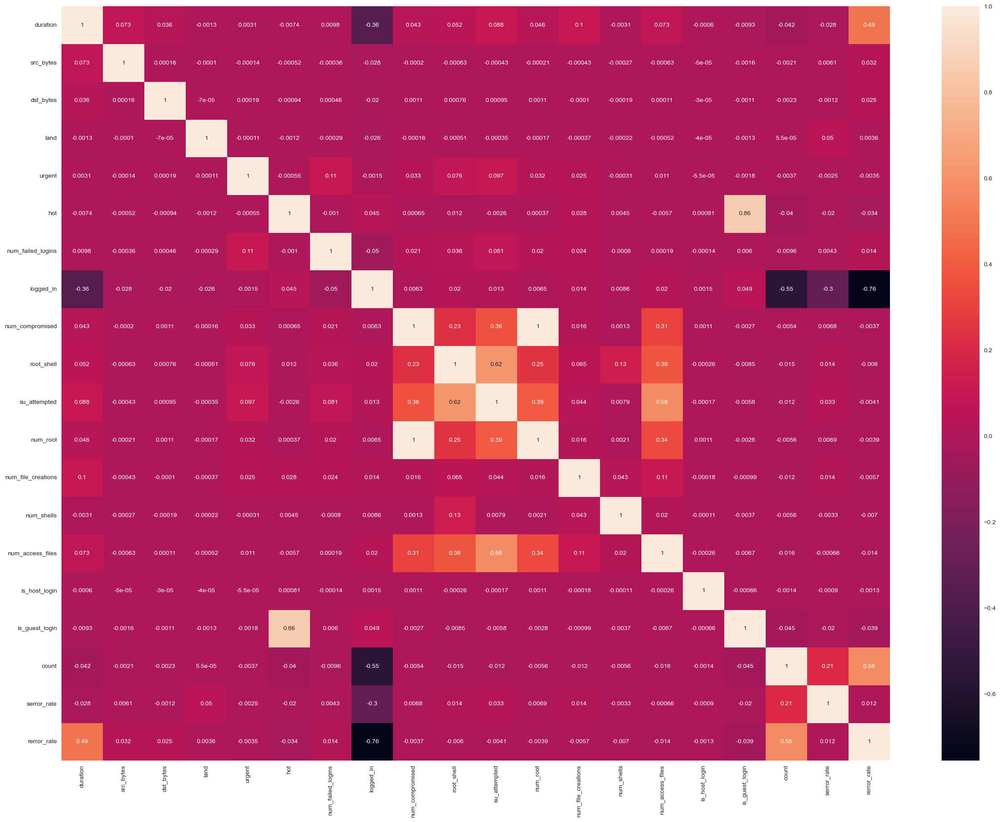

In [77]:
plt.figure(figsize=(30,22))
plt.rcParams['font.size']=10
sns.heatmap(train_df_enc_x.corr(), annot=True)

<h2>Choisir le nombre optimal de composants principal </h2>

Nombre de composantes calculées :  20


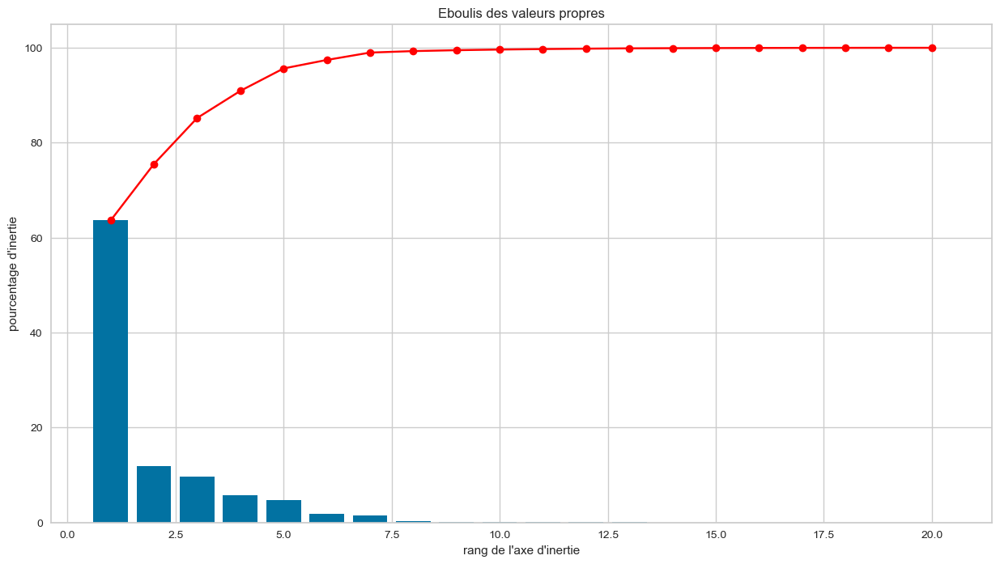

PCA(n_components=20)

In [78]:
from sklearn.decomposition import PCA

# fonction pour afficher les composantes principales
def display_scree_plot(pca):
    scree = pca.explained_variance_ratio_*100
    plt.bar(np.arange(len(scree))+1, scree)
    plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
    plt.xlabel("rang de l'axe d'inertie")
    plt.ylabel("pourcentage d'inertie")
    plt.title("Eboulis des valeurs propres")
    plt.show(block=False)


n_comp = 20

# Calcul des composantes principales
pca = PCA(20)
pca.fit(train_df_enc_x)
print('Nombre de composantes calculées : ', pca.n_components_)

# Eboulis des valeurs propres
plt.figure( figsize = ( 15, 8)) 
display_scree_plot(pca)
pca

In [79]:
#appliquer le PCA pour avoir 4 composants (n_components=4) 
# du moment que 4 composants nous permettent d'avoir 100% de l'information
pca = PCA(n_components=4).fit(train_df_enc_x)
train_df_enc_x_pca = pca.transform(train_df_enc_x)
test_df_enc_x_pca = pca.transform(test_df_enc_x)



In [80]:
#affichage en dataframe
features_pca=['PC'+str(i+1) for i in range(pca.n_components_)]
train_x_pca = pd.DataFrame(train_df_enc_x_pca,columns=features_pca)
train_x_pca
test_x_pca = pd.DataFrame(test_df_enc_x_pca,columns=features_pca)
test_x_pca

,PC1,PC2,PC3,PC4
0,1.312109,-0.228378,-0.011397,0.195184
1,1.274262,-0.232267,-0.008184,0.071868
2,0.646831,0.317610,0.015833,-0.455696
3,0.646827,0.317616,0.015833,-0.455686
4,1.219325,-0.237916,-0.003520,-0.107144
...,...,...,...,...
22539,-0.133743,-0.016394,-0.025888,-0.010273
22540,-0.133336,-0.016352,-0.025923,-0.008947
22541,-0.132224,-0.016520,-0.021251,-0.004868
22542,0.648048,0.317741,0.015730,-0.451708


<h2>afficher la corrélation après l'application du PCA</h2>

<AxesSubplot:>

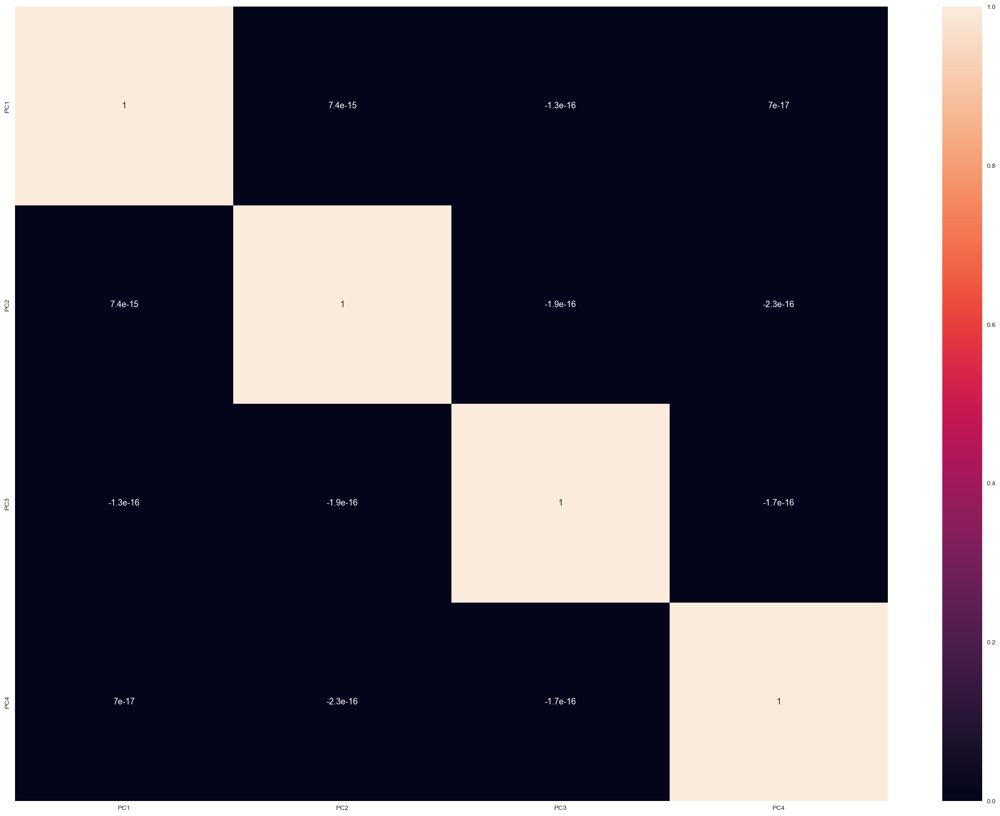

In [81]:
plt.figure(figsize=(30,22))
plt.rcParams['font.size']=13
sns.heatmap(train_x_pca.corr(), annot=True)


On voit ici que la correlation est minime entre les differentes features, donc le PCA a bien éliminé la correlation entre les features

<h1> GMM </h1>

In [82]:
!pip install yellowbrick

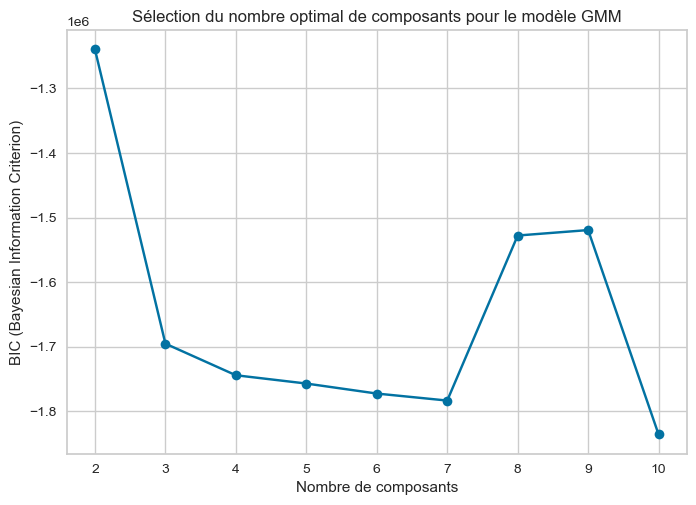

In [83]:
#pour determiner combien de clusters on en a besoin
from sklearn.mixture import GaussianMixture
import matplotlib.pyplot as plt

# Remplacez train_x_pca par votre ensemble de données
X = train_x_pca

# Testez différentes valeurs de n_components
n_components_range = range(2, 11)
bic_scores = []

for n_components in n_components_range:
    gmm = GaussianMixture(n_components=n_components, covariance_type='full', random_state=42)
    gmm.fit(X)
    bic_scores.append(gmm.bic(X))

# Affichez le graphique de la log-vraisemblance (BIC)
plt.plot(n_components_range, bic_scores, marker='o')
plt.xlabel('Nombre de composants')
plt.ylabel('BIC (Bayesian Information Criterion)')
plt.title('Sélection du nombre optimal de composants pour le modèle GMM')
plt.show()


In [84]:
#le model va clusteriser les données en 5 composants (groupes)(n_components=5)
from sklearn.mixture import GaussianMixture

gmm = GaussianMixture(n_components=5, covariance_type='full', random_state=42)
y_gmm=gmm.fit_predict(train_x_pca)


In [85]:
#calculer les scores et les stocker dans une colonne appelée score
score = gmm.score_samples(train_x_pca)
train_x_pca['score']=score

In [86]:
train_x_pca

,PC1,PC2,PC3,PC4,score
0,0.647234,0.317657,0.015799,-0.454360,15.286674
1,0.788411,1.064526,0.057516,0.091872,2.009662
2,-0.113728,0.132135,-0.016847,0.072189,3.157419
3,-0.121941,-0.015181,-0.026890,0.028181,18.017733
4,1.268158,-0.232895,-0.007666,0.051978,5.435848
...,...,...,...,...,...
49605,-0.128452,-0.015850,-0.026337,0.006965,20.956146
49606,-0.132929,-0.016310,-0.025957,-0.007621,21.024145
49607,-0.133743,-0.016393,-0.025888,-0.010272,20.865613
49608,-0.102590,0.228487,-0.010811,0.119690,3.228840


In [87]:
# Set a threshold for anomaly detection (e.g., using a percentile)
#on va définir une limite pour détécter les anomalies(ex:si on s'attend a avoir 5% d'anomalie, on met np.percentile(score, 5) 
threshold = np.percentile(score, 5)  # Adjust the percentile as needed

In [88]:
# Print the score threshold
print(f'The threshold of the score is {threshold:.2f}')

The threshold of the score is 2.91


In [89]:
# Label the anomalies
#suite a cette commande la dataframe train_x_pca contiendra une nouvelle colonne qui prendra 1 s'il ya anomalie
train_x_pca['anomaly_gmm_pct'] = train_x_pca['score'].apply(lambda x: 1 if x < threshold else 0)
train_x_pca

,PC1,PC2,PC3,PC4,score,anomaly_gmm_pct
0,0.647234,0.317657,0.015799,-0.454360,15.286674,0
1,0.788411,1.064526,0.057516,0.091872,2.009662,1
2,-0.113728,0.132135,-0.016847,0.072189,3.157419,0
3,-0.121941,-0.015181,-0.026890,0.028181,18.017733,0
4,1.268158,-0.232895,-0.007666,0.051978,5.435848,0
...,...,...,...,...,...,...
49605,-0.128452,-0.015850,-0.026337,0.006965,20.956146,0
49606,-0.132929,-0.016310,-0.025957,-0.007621,21.024145,0
49607,-0.133743,-0.016393,-0.025888,-0.010272,20.865613,0
49608,-0.102590,0.228487,-0.010811,0.119690,3.228840,0


In [90]:
#affichage du nombre d'anomalies
train_x_pca[train_x_pca['anomaly_gmm_pct']==1].shape[0]

2481

## k-means

In [91]:
# à installer si c'est la première à utiliser yellowbrick.cluster
!pip install yellowbrick

C:\Users\chino\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1036: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


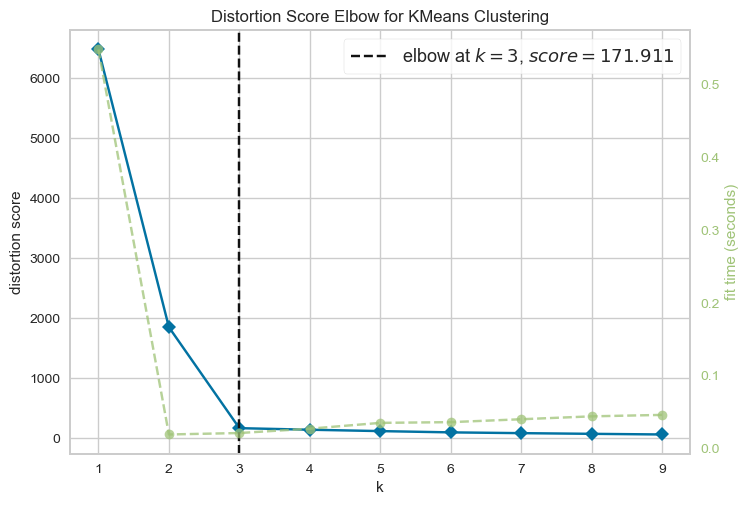

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [93]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
from sklearn.datasets import make_blobs
# Utilisation de l'algorithme KMeans avec Yellowbrick
model = KMeans(n_init=10)

# Initialisation du visualiseur du coude avec un intervalle de clusters de 1 à 10
visualizer = KElbowVisualizer(model, k=(1, 10))

# Ajustement du modèle et création du graphique du coude
visualizer.fit(data_tr)

# Affichage du graphique
visualizer.show()


## Construction du modèle K-means

In [95]:

# Création d'une instance du modèle KMeans avec 3 clusters et une initialisation aléatoire
model1 = KMeans(n_clusters=3, random_state=42)

# Entraînement du modèle sur l'ensemble de données d'entraînement
model1.fit(data_tr)


KMeans(n_clusters=3, random_state=42)

- L'algorithme KMeans est utilisé pour partitionner les données en trois clusters.
- Le paramètre 'n_clusters' spécifie le nombre de clusters à former.
 - 'random_state' permet de reproduire les mêmes résultats d'une exécution à l'autre.

 À la fin de cet entraînement, le modèle a assigné chaque point de données à l'un des trois clusters.

In [104]:
from sklearn.metrics import silhouette_score
import numpy as np
from sklearn.datasets import make_blobs

# Assurez-vous de définir data_tr et model1 ou utilisez un ensemble de données et un modèle approprié
# Par exemple, vous pouvez créer un ensemble de données fictif pour l'exemple
data_tr, _ = make_blobs(n_samples=100, centers=3, random_state=42)

# Définir model1 (vous devez avoir déjà défini le modèle KMeans)
model1 = KMeans(n_clusters=3, random_state=42)
model1.fit(data_tr)

# Prédiction des clusters pour les données d'entraînement
cluster_labels_tr = model1.labels_

# Calculer le score de silhouette pour toutes les données
silhouette_avg = silhouette_score(data_tr, cluster_labels_tr)

# Afficher le score de silhouette moyen pour toutes les données
print(f"Silhouette Score: {silhouette_avg}")


Silhouette Score: 0.8469881221532085


Le score de silhouette (Silhouette Score) est une mesure de la qualité de la séparation des clusters dans un ensemble de données. Il fournit une indication de la proximité des points d'un cluster les uns par rapport aux autres par rapport aux points des autres clusters.


# interpretation :

Un score proche de 1 indique que l'objet est bien adapté à son propre cluster et mal adapté aux clusters voisins

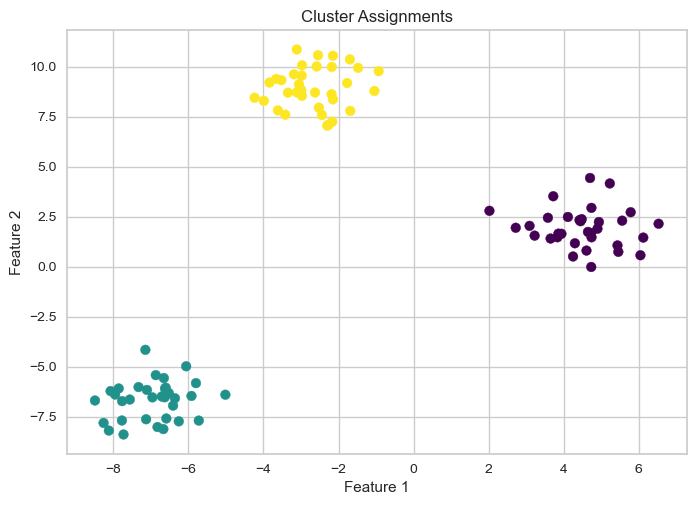

Data point 1 is assigned to cluster 1
Data point 2 is assigned to cluster 0
Data point 3 is assigned to cluster 2
Data point 4 is assigned to cluster 0
Data point 5 is assigned to cluster 1
Data point 6 is assigned to cluster 0
Data point 7 is assigned to cluster 2
Data point 8 is assigned to cluster 0
Data point 9 is assigned to cluster 0
Data point 10 is assigned to cluster 2
Data point 11 is assigned to cluster 2
Data point 12 is assigned to cluster 1
Data point 13 is assigned to cluster 1
Data point 14 is assigned to cluster 2
Data point 15 is assigned to cluster 2
Data point 16 is assigned to cluster 1
Data point 17 is assigned to cluster 1
Data point 18 is assigned to cluster 2
Data point 19 is assigned to cluster 1
Data point 20 is assigned to cluster 1
Data point 21 is assigned to cluster 2
Data point 22 is assigned to cluster 1
Data point 23 is assigned to cluster 1
Data point 24 is assigned to cluster 2
Data point 25 is assigned to cluster 2
Data point 26 is assigned to clust

In [106]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # If working with 3D data

# Assuming your data has 2 or 3 features for simplicity in visualization
if data_tr.shape[1] == 2:
    plt.scatter(data_tr[:, 0], data_tr[:, 1], c=cluster_labels_tr, cmap='viridis')
    plt.title('Cluster Assignments')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.show()
elif data_tr.shape[1] == 3:
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(data_tr[:, 0], data_tr[:, 1], data_tr[:, 2], c=cluster_labels_tr, cmap='viridis')
    ax.set_title('Cluster Assignments')
    ax.set_xlabel('Feature 1')
    ax.set_ylabel('Feature 2')
    ax.set_zlabel('Feature 3')
    plt.show()
else:
    # If data has more than 3 features, visualization is not supported
    print("Data has more than 3 features. Visualization not supported.")

# Print the cluster assignments for each point
for i in range(len(data_tr)):
    print(f"Data point {i+1} is assigned to cluster {cluster_labels_tr[i]}")


Cela vous donne une représentation visuelle de la manière dont votre algorithme KMeans a regroupé les points de données dans des clusters distincts. Vous pouvez interpréter la visualisation en observant comment les points sont regroupés dans des zones distinctes du graphique en fonction de leurs caractéristiques.

In [110]:
# Create a DataFrame with the results
df_results = pd.DataFrame({'Observation': np.arange(len(data_tr)), 'Assigned_Cluster': labels})
df_results['Distance_to_Centroid'] = distances_to_centroids[np.arange(len(distances_to_centroids)), model1.labels_]
# Create a DataFrame for percentage_by_cluster
percentage_by_cluster = pd.DataFrame(distances_to_centroids, columns=[f'Cluster_{i}' for i in range(model1.n_clusters)])
percentage_by_cluster['Assigned_Cluster'] = labels
percentage_by_cluster['Observation'] = np.arange(len(data_tr))
percentage_by_cluster.iloc[:, :-2] = percentage_by_cluster.iloc[:, :-2].apply(lambda x: x / x.sum() * 100, axis=1)


In [111]:
total_normal = np.sum(np.logical_or(labels == 'Normal', labels == 'Normal'))  
total_abnormal = np.sum(labels == 'Abnormal')

print(f'Total observations in normal clusters: {total_normal}')
print(f'Total observations in abnormal cluster: {total_abnormal}')

Total observations in normal clusters: 66
Total observations in abnormal cluster: 34


In [114]:
import numpy as np
import pandas as pd

# Mise à jour des affectations des clusters en étiquetant les points comme "Normal" ou "Abnormal"
labels = np.where(model1.labels_ == 0, 'Normal', np.where(model1.labels_ == 1, 'Abnormal', 'Normal'))

# Calcul des distances entre chaque point de données et les centroïdes des clusters
distances_to_centroids = model1.transform(data_tr)

# Création du DataFrame df_results pour résumer les affectations des clusters et les distances aux centroïdes
df_results = pd.DataFrame({'Observation': np.arange(len(data_tr)), 'Assigned_Cluster': labels})
df_results['Distance_to_Centroid'] = distances_to_centroids[np.arange(len(distances_to_centroids)), model1.labels_]

# Création du DataFrame percentage_by_cluster pour représenter les pourcentages de distances par cluster
percentage_by_cluster = pd.DataFrame(distances_to_centroids, columns=[f'Cluster_{i}' for i in range(model1.n_clusters)])
percentage_by_cluster['Assigned_Cluster'] = labels
percentage_by_cluster['Observation'] = np.arange(len(data_tr))
percentage_by_cluster.iloc[:, :-2] = percentage_by_cluster.iloc[:, :-2].apply(lambda x: x / x.sum() * 100, axis=1)

# Affichage des résultats
print(df_results)
print(percentage_by_cluster)

# Calcul du nombre total d'observations étiquetées comme "Normal" et "Abnormal"
total_normal1 = np.sum(labels == 'Normal')
total_abnormal1 = np.sum(labels == 'Abnormal')

print(f'Total observations in normal clusters: {total_normal1}')
print(f'Total observations in abnormal cluster: {total_abnormal1}')


    Observation Assigned_Cluster  Distance_to_Centroid
0             0         Abnormal              1.885271
1             1           Normal              1.530289
2             2           Normal              0.694540
3             3           Normal              2.061962
4             4         Abnormal              0.558713
..          ...              ...                   ...
95           95           Normal              0.863151
96           96           Normal              1.560407
97           97           Normal              0.438799
98           98         Abnormal              1.434113
99           99           Normal              0.718643

[100 rows x 3 columns]
    Cluster_0  Cluster_1  Cluster_2 Assigned_Cluster  Observation
0   44.532320   5.244530  50.223150         Abnormal            0
1    5.560501  52.520825  41.918674           Normal            1
2   38.014076  59.512644   2.473280           Normal            2
3    7.106023  51.276208  41.617769           Normal

In [117]:
import numpy as np
import pandas as pd

# Assuming labels are assigned as 'Normal' and 'Abnormal' based on model1.labels_
labels = np.where(model1.labels_ <= 1, 'Normal', 'Abnormal')

# Determine which cluster is considered normal and abnormal
normal_cluster = np.unique(model1.labels_[labels == 'Normal'])
abnormal_cluster = np.unique(model1.labels_[labels == 'Abnormal'])

# Print the clusters considered as Normal and Abnormal
print(f'Cluster(s) considered as Normal: {normal_cluster}')
print(f'Cluster(s) considered as Abnormal: {abnormal_cluster}')

# Rest of your code

# Transform data based on cluster assignments
distances_to_centroids = model1.transform(data_tr)

# Create a DataFrame to store the results
df_results = pd.DataFrame({'Observation': np.arange(len(data_tr)), 'Assigned_Cluster': labels})
df_results['Distance_to_Centroid'] = distances_to_centroids[np.arange(len(distances_to_centroids)), model1.labels_]

# Create a DataFrame for percentage contribution by cluster
percentage_by_cluster = pd.DataFrame(distances_to_centroids, columns=[f'Cluster_{i}' for i in range(model1.n_clusters)])
percentage_by_cluster['Assigned_Cluster'] = labels
percentage_by_cluster['Observation'] = np.arange(len(data_tr))
percentage_by_cluster.iloc[:, :-2] = percentage_by_cluster.iloc[:, :-2].apply(lambda x: x / x.sum() * 100, axis=1)

# Print the results
print(df_results)
print(percentage_by_cluster)



Cluster(s) considered as Normal: [0 1]
Cluster(s) considered as Abnormal: [2]
    Observation Assigned_Cluster  Distance_to_Centroid
0             0           Normal              1.885271
1             1           Normal              1.530289
2             2         Abnormal              0.694540
3             3           Normal              2.061962
4             4           Normal              0.558713
..          ...              ...                   ...
95           95         Abnormal              0.863151
96           96         Abnormal              1.560407
97           97           Normal              0.438799
98           98           Normal              1.434113
99           99         Abnormal              0.718643

[100 rows x 3 columns]
    Cluster_0  Cluster_1  Cluster_2 Assigned_Cluster  Observation
0   44.532320   5.244530  50.223150           Normal            0
1    5.560501  52.520825  41.918674           Normal            1
2   38.014076  59.512644   2.473280     

Cluster Sizes: [33 33 34]


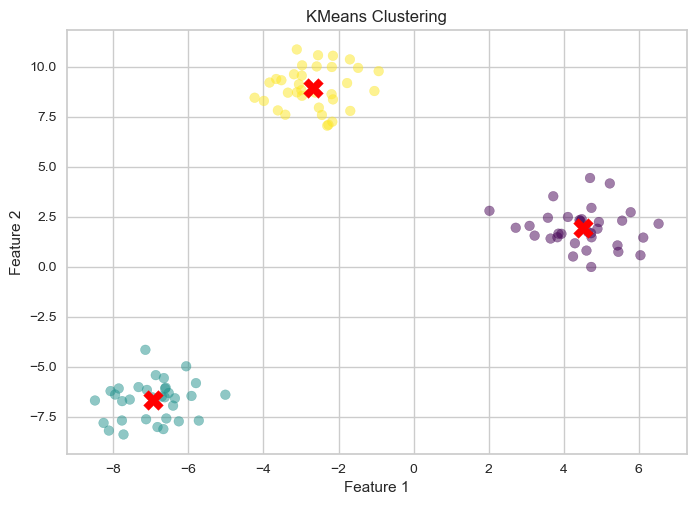

The cluster considered as normal: 2


In [119]:
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Création du modèle KMeans avec 3 clusters
model = KMeans(n_clusters=3, random_state=42)

# Prédiction des clusters pour les données d'entraînement
labels = model.fit_predict(data_tr)

# Calcul des occurrences de chaque cluster
cluster_counts = np.bincount(labels)

# Identification de l'indice du cluster le plus fréquent (considéré comme "normal")
normal_cluster_index = np.argmax(cluster_counts)

# Affichage des tailles des clusters
print("Cluster Sizes:", cluster_counts)

# Affichage des points de données colorés par cluster et des centres de cluster en rouge
plt.scatter(data_tr[:, 0], data_tr[:, 1], c=labels, cmap='viridis', alpha=0.5)
plt.scatter(model.cluster_centers_[:, 0], model.cluster_centers_[:, 1], c='red', marker='X', s=200)
plt.title('KMeans Clustering')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.show()

# Affichage de l'indice du cluster considéré comme "normal"
print(f'The cluster considered as normal: {normal_cluster_index}')


In [121]:
import numpy as np
import pandas as pd

# Assuming labels are assigned as 'Normal' and 'Abnormal' based on model1.labels_
labels = np.where(model1.labels_ == 1, 'Normal', 'Abnormal')

# Determine which cluster is considered normal and abnormal
normal_cluster = np.unique(model1.labels_[labels == 'Normal'])
abnormal_cluster = np.unique(model1.labels_[labels == 'Abnormal'])

# Rest of your code
distances_to_centroids = model1.transform(data_tr)

# Create DataFrame with 'Observation' as indices
df_results = pd.DataFrame({'Observation': np.arange(len(data_tr)), 'Assigned_Cluster': labels})
df_results['Distance_to_Centroid'] = distances_to_centroids[np.arange(len(distances_to_centroids)), model1.labels_]

percentage_by_cluster = pd.DataFrame(distances_to_centroids, columns=[f'Cluster_{i}' for i in range(model1.n_clusters)])
percentage_by_cluster['Assigned_Cluster'] = labels
percentage_by_cluster['Observation'] = np.arange(len(data_tr))
percentage_by_cluster.iloc[:, :-2] = percentage_by_cluster.iloc[:, :-2].apply(lambda x: x / x.sum() * 100, axis=1)

print(df_results)
print(percentage_by_cluster)


    Observation Assigned_Cluster  Distance_to_Centroid
0             0           Normal              1.885271
1             1         Abnormal              1.530289
2             2         Abnormal              0.694540
3             3         Abnormal              2.061962
4             4           Normal              0.558713
..          ...              ...                   ...
95           95         Abnormal              0.863151
96           96         Abnormal              1.560407
97           97         Abnormal              0.438799
98           98           Normal              1.434113
99           99         Abnormal              0.718643

[100 rows x 3 columns]
    Cluster_0  Cluster_1  Cluster_2 Assigned_Cluster  Observation
0   44.532320   5.244530  50.223150           Normal            0
1    5.560501  52.520825  41.918674         Abnormal            1
2   38.014076  59.512644   2.473280         Abnormal            2
3    7.106023  51.276208  41.617769         Abnormal

In [ ]:
colormap=np.array(['Red','green','bleu'])

plt.scatter(data_tr.dst_host_serror_rate, data_tr.dst_host_srv_count,c=colormap[model1.labels_])

Column names: Index(['dst_host_serror_rate', 'dst_host_srv_count', 'serror_rate'], dtype='object')
DataFrame type: <class 'pandas.core.frame.DataFrame'>
DataFrame head:
    dst_host_serror_rate  dst_host_srv_count  serror_rate
0                   NaN                 NaN          NaN
1                   NaN                 NaN          NaN
2                   NaN                 NaN          NaN
3                   NaN                 NaN          NaN
4                   NaN                 NaN          NaN


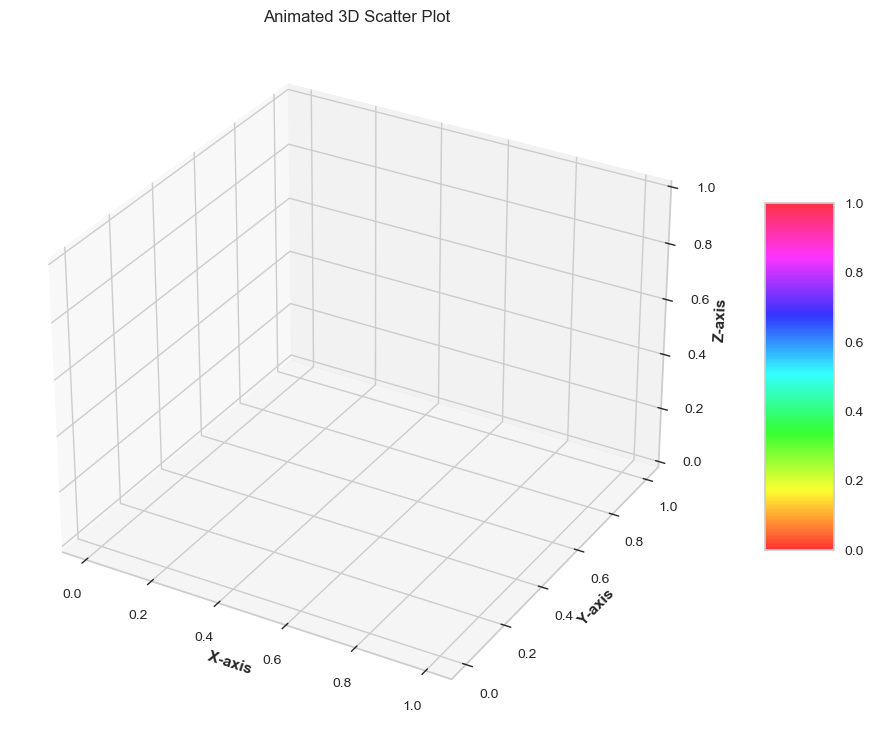

In [134]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
import pandas as pd

# Assuming X is your data
# Replace X with your actual data

# Convert NumPy array to DataFrame
data_tr = pd.DataFrame(X, columns=['dst_host_serror_rate', 'dst_host_srv_count', 'serror_rate'])

# Print column names
print("Column names:", data_tr.columns)

# Check DataFrame type
print("DataFrame type:", type(data_tr))

# Convert columns to numeric if needed
data_tr['dst_host_serror_rate'] = pd.to_numeric(data_tr['dst_host_serror_rate'], errors='coerce')
data_tr['dst_host_srv_count'] = pd.to_numeric(data_tr['dst_host_srv_count'], errors='coerce')
data_tr['serror_rate'] = pd.to_numeric(data_tr['serror_rate'], errors='coerce')

# Print the first few rows of the DataFrame
print("DataFrame head:\n", data_tr.head())

# Creating figure
fig = plt.figure(figsize=(16, 9))
ax = plt.axes(projection="3d")

# Add x, y gridlines
ax.grid(visible=True, color='grey', linestyle='-.', linewidth=0.3, alpha=0.2)

# Creating color map
my_cmap = plt.get_cmap('hsv')

# Creating plot
sctt = ax.scatter3D(data_tr['dst_host_serror_rate'], data_tr['dst_host_srv_count'], data_tr['serror_rate'], alpha=0.8,
                    c=(data_tr['dst_host_serror_rate'] + data_tr['dst_host_srv_count'] + data_tr['serror_rate']),
                    cmap=my_cmap,
                    marker='^')

plt.title("Animated 3D Scatter Plot")
ax.set_xlabel('X-axis', fontweight='bold')
ax.set_ylabel('Y-axis', fontweight='bold')
ax.set_zlabel('Z-axis', fontweight='bold')
fig.colorbar(sctt, ax=ax, shrink=0.5, aspect=5)

def update(frame):
    ax.view_init(elev=20, azim=frame)  # Rotate the view around the azimuthal axis
    return sctt,

animation = FuncAnimation(fig, update, frames=range(0, 360, 2), interval=50)
plt.show()


C:\Users\chino\AppData\Local\Temp\ipykernel_4588\3229439600.py:8: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped two minor releases later.
  ax.grid(b=True, color='grey', linestyle='-.', linewidth=0.3, alpha=0.2)
C:\Users\chino\anaconda3\lib\site-packages\matplotlib\animation.py:887: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you have outputted the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(
Animation size has reached 21015624 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


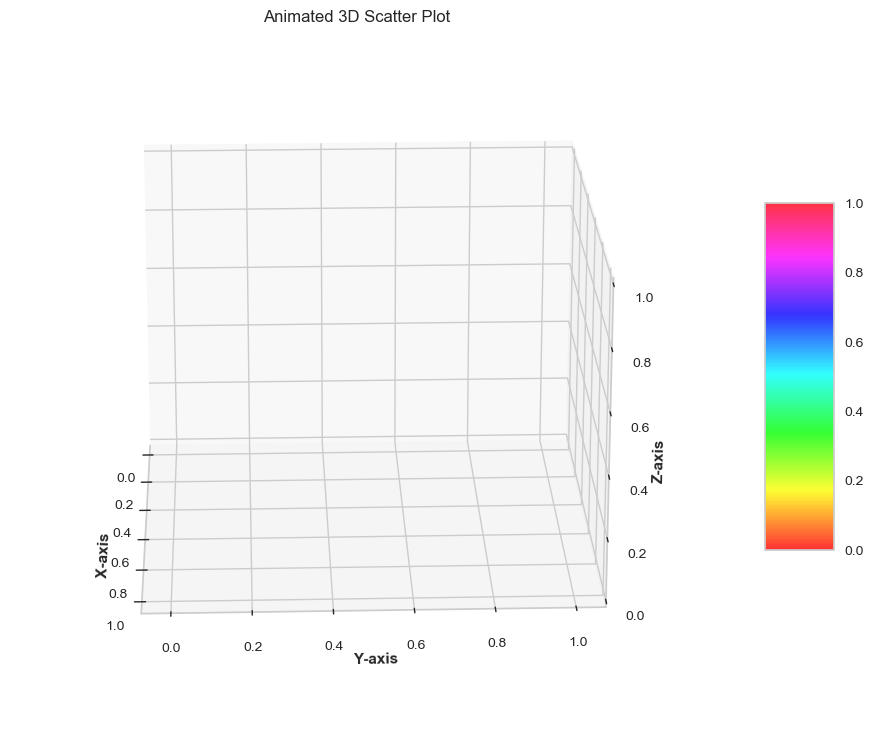

In [135]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
%matplotlib inline
fig = plt.figure(figsize=(16, 9))
ax = plt.axes(projection="3d")
ax.grid(b=True, color='grey', linestyle='-.', linewidth=0.3, alpha=0.2)
my_cmap = plt.get_cmap('hsv')
sctt = ax.scatter3D(data_tr.dst_host_serror_rate, data_tr.dst_host_srv_count, data_tr.serror_rate, alpha=0.8,
c=(data_tr.dst_host_serror_rate+data_tr.dst_host_srv_count + data_tr.serror_rate),
cmap=my_cmap,marker='^')
plt.title("Animated 3D Scatter Plot")
ax.set_xlabel('X-axis', fontweight='bold')
ax.set_ylabel('Y-axis', fontweight='bold')
ax.set_zlabel('Z-axis', fontweight='bold')
fig.colorbar(sctt, ax=ax, shrink=0.5, aspect=5)
def update(frame):
    ax.view_init(elev=20, azim=frame)  
    return sctt,
animation = FuncAnimation(fig, update, frames=range(0, 360, 2), interval=50)
html_output = animation.to_jshtml()
HTML(html_output)


In [141]:
import numpy as np
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler

# Assuming X is your data
# Replace X with your actual data

# Convert NumPy array to DataFrame
data_tr = pd.DataFrame(X, columns=['dst_host_serror_rate', 'dst_host_srv_count', 'serror_rate'])

# Check for missing values
missing_values = data_tr.isnull().sum()
print("Missing values in the dataset:")
print(missing_values)

# Drop rows with missing values
data_tr = data_tr.dropna()

# Check if there are still any samples after dropping rows
num_samples = len(data_tr)
print("Number of samples in the dataset after dropping missing values:", num_samples)

# Proceed only if there are samples
if num_samples > 0:
    # Scale the data using MinMaxScaler
    scaler = MinMaxScaler()
    data_tr_scaled = scaler.fit_transform(data_tr)

    # Fit KMeans model
    model1 = KMeans(n_clusters=2, random_state=42)
    model1.fit(data_tr_scaled)

    # Labels and distances to centroids
    labels = np.where(model1.labels_ == 0, 'Abnormal', np.where(model1.labels_ == 1, 'Normal', 'Abnormal'))
    distances_to_centroids = model1.transform(data_tr_scaled)

    # Create DataFrames for results
    df_results = pd.DataFrame({'Observation': data_tr.index, 'Assigned_Cluster': labels})
    df_results['Distance_to_Centroid'] = distances_to_centroids[np.arange(len(distances_to_centroids)), model1.labels_]

    percentage_by_cluster = pd.DataFrame(distances_to_centroids, columns=[f'Cluster_{i}' for i in range(model1.n_clusters)])
    percentage_by_cluster['Assigned_Cluster'] = labels
    percentage_by_cluster['Observation'] = data_tr.index
    percentage_by_cluster.iloc[:, :-2] = percentage_by_cluster.iloc[:, :-2].apply(lambda x: x / x.sum() * 100, axis=1)

    print("Results DataFrame:")
    print(df_results)
    print("\nPercentage by Cluster DataFrame:")
    print(percentage_by_cluster)

    # Calculate total observations in normal and abnormal clusters
    total_normal2 = np.sum(labels == 'Normal')
    total_abnormal2 = np.sum(labels == 'Abnormal')

    print(f'\nTotal observations in normal clusters: {total_normal2}')
    print(f'Total observations in abnormal cluster: {total_abnormal2}')

else:
    print("No samples remaining after dropping missing values. Unable to proceed.")


Missing values in the dataset:
dst_host_serror_rate    49610
dst_host_srv_count      49610
serror_rate             49610
dtype: int64
Number of samples in the dataset after dropping missing values: 0
No samples remaining after dropping missing values. Unable to proceed.
